In [26]:
import collections
import sys
from pathlib import Path

import matplotlib.pyplot as plt
import matplotlib.transforms as mtrans
import matplotlib.patches as mpatches
import numpy as np
import pandas as pd
from skimage import exposure
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
import matplotlib.font_manager as fm
import cv2
fontprops = fm.FontProperties(size=34)
from sklearn.neighbors import NearestNeighbors
from skimage import color, measure, filters
import seaborn as sns
from matplotlib.colors import ListedColormap
import os
import skimage
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from skimage import filters
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1 import ImageGrid
from skimage.filters.rank import median
from skimage.morphology import disk, ball

In [27]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [28]:
# Import path
module_path = str(Path.cwd().parents[0])
if module_path not in sys.path:
    sys.path.append(module_path)
    
module_path = str(Path.cwd().parents[0] / "src")
if module_path not in sys.path:
    sys.path.append(module_path)
    

In [29]:
from config import *
import my_io as io

# Import metadata information

In [30]:
df_metadata = pd.read_csv(data_dir / 'metadata.csv')
df_metadata.head()

,Pos,Grades,Stage,Directory
0,B1,2,I,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI001_B1
1,B3,2,I,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI005_B3
2,B5,2,II,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI006_B5
3,C6,AT,AT,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI007_C6
4,D7,3,IIIA,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI008_D7


In [31]:
datasets = df_metadata.Directory.to_list()
datasets = [name.split('\\')[-1] for name in datasets]

In [32]:
print(datasets)

['ROI001_B1', 'ROI005_B3', 'ROI006_B5', 'ROI007_C6', 'ROI008_D7', 'ROI009_D9', 'ROI012_E1', 'ROI015_B6', 'ROI016_F3', 'ROI017_F2', 'ROI018_G1', 'ROI019_G5', 'ROI020_E5', 'ROI021_E7']


# Cell neighborhood analysis

In [33]:
import networkx as nx

def read_cell_mask(ROI: str):
    """Read all image from one ROI"""
    dir_ = data_figure / 'mask_DL'

    # Get images in directory
    dirpath, _, filenames = next(os.walk(dir_))
    for name in filenames:
        if 'both' in name:
            continue
        elif ROI in name and 'cyto' in name:
            mask_name = name
    mask = skimage.io.imread(os.path.join(dirpath, mask_name))
    return mask

def get_cell_expression_level_mean(imgs_list, labels, cell_mask):
    # Multiple each cell region by mean intensity 
    df_list = []
    for idx, img in enumerate(imgs_list):
        exp_prop = pd.DataFrame(measure.regionprops_table(cell_mask, img, properties=['label','mean_intensity'])).set_index('label')

        df = exp_prop.rename(columns = {'mean_intensity': labels[idx]}, errors = 'raise')
        df_list.append(df)
    df_exp = pd.concat(df_list, axis=1)
    return df_exp

def get_distances(cell_mask, r=30):
    # NN classifier
    neigh = NearestNeighbors(radius=r)
    
    # Get centroid of cellmask
    prop = measure.regionprops_table(cell_mask, properties=['label',"centroid"])
    X = np.column_stack((prop["centroid-0"], prop["centroid-1"]))
    
    # fit the k-NN classifier
    neigh.fit(X)
    distances, neighbors = neigh.radius_neighbors(X, return_distance=True, sort_results=True)
    graph = neigh.radius_neighbors_graph(X, mode='distance').toarray()
    return distances, neighbors, prop['label'], graph, X

def connectpoints(x,y,p1,p2):
    x1, x2 = x[p1], x[p2]
    y1, y2 = y[p1], y[p2]
    plt.plot([x1,x2],[y1,y2],"b-", color='red', alpha=1, lw=1, zorder=0)

def plot_nn(X, graph, node_colors, ax):
    G = nx.from_numpy_array(graph)
    pos = dict(zip(np.arange(len(X)), X[:,[1,0]]))
    nx.draw(G, pos, node_size=30, node_color=node_colors, edge_color='sandybrown', linewidths=2, ax=ax)
    
def get_cell_color(df, labels, rgb):

    label2num = dict(zip(labels, [i for i in range(len(labels))]))
    num2color = dict([(i, rgb[i]/255) for i in range(len(labels)+1)])
    
    cell_max_marker = df.idxmax(axis=1)
    cell_max_marker = cell_max_marker.apply(label2num.get)
    
    
    index_low = (df < 0).all(axis=1)
    cell_max_marker[index_low] = 4
    cell_max_color = cell_max_marker.apply(num2color.get)
    
    return cell_max_marker.to_dict(), cell_max_color.values

def replace_with_dict(ar, dic):
    dic[0] = np.nan
    
    # Extract out keys and values
    k = np.array(list(dic.keys()))
    v = np.array(list(dic.values()))

    # Get argsort indices
    sidx = k.argsort()

    ks = k[sidx]
    vs = v[sidx]
    return vs[np.searchsorted(ks,ar)]

def myround(x, base=5):
    return base * round(x/base)

In [34]:
from collections import defaultdict
from numpy.lib.stride_tricks import as_strided

def get_nei_info(cell_labels, neighbors, node_class, distances):
    node_nei_info = defaultdict(dict)
    for idx, node in enumerate(cell_labels):
        neighbor = neighbors[idx][1:]
        nei_class = np.array([node_class[cell_labels[n]] for n in neighbor])
        nei_distance = distances[idx][1:]   # First distance always correspond to 0 for item itself

        unique, counts = np.unique(nei_class, return_counts=True)
        for idx, c in enumerate(unique):
            node_nei_info[node][c] = {
                'count': counts[idx], 
                'avg_distance': np.mean(nei_distance[np.where(nei_class == c)])
            }
    return node_nei_info
                             
def get_node_patch(X, node_class, n):
    nodes = node_class.keys()
    patches = X//n
    return dict(zip(nodes, patches))

def tile_array(a, b0, b1):
    r, c = a.shape                                    # number of rows/columns
    rs, cs = a.strides                                # row/column strides 
    x = as_strided(a, (r, b0, c, b1), (rs, 0, cs, 0)) # view a as larger 4D array
    return x.reshape(r*b0, c*b1)                      # create new 2D array

def patch_count(c, node_class, node_patch, n, shape):
    matching_node = [k for k, v in node_class.items() if v == c]
    patch_matrix = np.zeros(tuple(d//n for d in shape))
    for node in matching_node:
        i, j = node_patch[node]
        i = int(i)
        j = int(j)
        patch_matrix[i][j] += 1
    patch_matrix = patch_matrix
    return patch_matrix

def patch_count_neighbor(c1, c2, neighbor_class, node_class, node_patch, n, shape):
    patch_matrix = np.zeros(tuple(d//n for d in shape))
    for node, neighbors in neighbor_class.items():
        if neighbors.get(c2) and node_class[node] == c1:
            i, j = node_patch[node]
            i = int(i)
            j = int(j)
            patch_matrix[i][j] += neighbors.get(c2)['count']
    patch_matrix = patch_matrix
    return patch_matrix

def count_neighbor(c1, c2, neighbor_class, node_class):
    count = 0
    for node, neighbors in neighbor_class.items():
        if neighbors.get(c2) and node_class[node] == c1:
            count += neighbors.get(c2)['count']
    return count

def plot_count_patch(node_class, node_patch, n, shape, path=None):
    patch_matrix = []
    for c in range(4):
        patch_matrix.append(patch_count(c, node_class, node_patch, n, shape))

    fig, axs = plt.subplots(2,2, figsize = (12,10))
    ax = axs.flatten()
    norm = plt.Normalize(vmin=np.min(patch_matrix),
                         vmax=np.max(patch_matrix))
    for c, ax in enumerate(ax):
        ax.axis('off')
        im = ax.imshow(patch_matrix[c], cmap = 'RdYlBu_r', norm=norm)
        ax.title.set_text(labels[c])
    fig.subplots_adjust(hspace=0.1, wspace=0.01)
    cbar = fig.colorbar(im, ax=axs, shrink=0.5)
    cbar.set_label('Count')
    if path:
         fig.savefig(path, bbox_inches='tight')
    
def plot_interaction_patch(init_c, node_class, node_patch, n, shape, cmap, path=None):
    init_c = 0
    patch_matrix = []
    for c in range(4):
        patch_matrix.append(patch_count_neighbor(init_c, c, neighbor_class, node_patch, n, shape))

    fig, axs = plt.subplots(2,2, figsize = (12,10))
    ax = axs.flatten()
    norm = plt.Normalize(vmin=np.min(patch_matrix),
                         vmax=np.max(patch_matrix))
    for c, ax in enumerate(ax):
        ax.axis('off')
        im = ax.imshow(patch_matrix[c], cmap = cmap, norm=norm)
        ax.title.set_text(labels[c])
    fig.subplots_adjust(hspace=0.1, wspace=0.01)
    cbar = fig.colorbar(im, ax=axs, shrink=0.5)
    cbar.set_label('Count')
    if path:
         fig.savefig(path, bbox_inches='tight')

In [35]:
# rgb = np.array([[255,0,255], [0,255,0], [0,0,255], [255,255,0], [160,160,160]])

# for dataset in datasets[:12]:

#     # Read image and cell_mask
#     imgs, markers = io.read_img(dataset, data_ROI)
#     marker2img = dict(zip(markers, imgs))
#     cell_mask = read_cell_mask(dataset)
#     if cell_mask.shape[0] != cell_mask.shape[1]:
#         cell_mask = cell_mask
    
#     imgs_list = []
#     for markers in marker_list:
#         temp = []
#         for marker in markers:
#             img = marker2img[marker]
#             p2, p98 = np.percentile(img, (0, 99.9))
#             img = exposure.rescale_intensity(img, in_range=(p2, p98))
#             temp.append(img)
#         imgs_list.append(np.array(np.mean(temp, axis=(0))))

#     # Grayscale backgroun image
#     avg_img = np.array(np.mean(imgs, axis=(0)))

#     # Get cell neighbors analysis
#     distances, neighbors, cell_labels, graph, X = get_distances(cell_mask)
#     df = get_cell_expression_level_mean(imgs_list, labels, cell_mask)
#     node_class, node_colors = get_cell_color(df, labels, rgb)
    
#     #Plot proximity map
#     fig, ax = plt.subplots(figsize=(15,15))
#     ax.axis('off')
#     top, right = avg_img.shape
#     ax.imshow(avg_img, cmap='gray', alpha=0.7, aspect='auto', extent=[0,right,0,top], origin='lower')
#     plot_nn(X, graph, node_colors, ax)
#     ax.invert_yaxis()
#     fig.savefig(data_figure / 'border' / f'cell_graph_{dataset}.png', bbox_inches='tight')
    
#     #Plot cell mask
#     img = replace_with_dict(cell_mask , node_class)
#     fig, ax = plt.subplots(figsize=(10,10))
#     ax.imshow(img, cmap=mycmap, interpolation='None')
#     ax.get_xaxis().set_visible(False)
#     ax.get_yaxis().set_visible(False)
#     ax.set_facecolor('black')
#     fig.savefig(data_figure / 'border' / f'cell_mask_{dataset}.png', bbox_inches='tight')
    
#     # Patch count 
#     n=25
#     node_class, _ = get_cell_color(df, labels, rgb)
#     neighbor_class = get_nei_info(cell_labels, neighbors, node_class, distances)
#     node_patch = get_node_patch(X, node_class, n)
    
# #     plot_count_patch(node_class, node_patch, n, avg_img.shape, 
# #                 data_figure / 'border' / f'patch_count_{dataset}.png')
# #     plot_interaction_patch(0, node_class, node_patch, n, avg_img.shape, 'RdPu', 
# #                           data_figure / 'border' / f'int_tumor_{dataset}.png')
# #     plot_interaction_patch(1, node_class, node_patch, n, avg_img.shape, 'YlGn',
# #                           data_figure / 'border' / f'int_imn_{dataset}.png')
# #     plot_interaction_patch(2, node_class, node_patch, n, avg_img.shape, 'GnBu',
# #                           data_figure / 'border' / f'int_imp_{dataset}.png')
# #     plot_interaction_patch(3, node_class, node_patch, n, avg_img.shape, 'Oranges',
# #                           data_figure / 'border' / f'int_stroma_{dataset}.png')

<ipython-input-36-4a7c1637ac09>:47: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=(15,15))


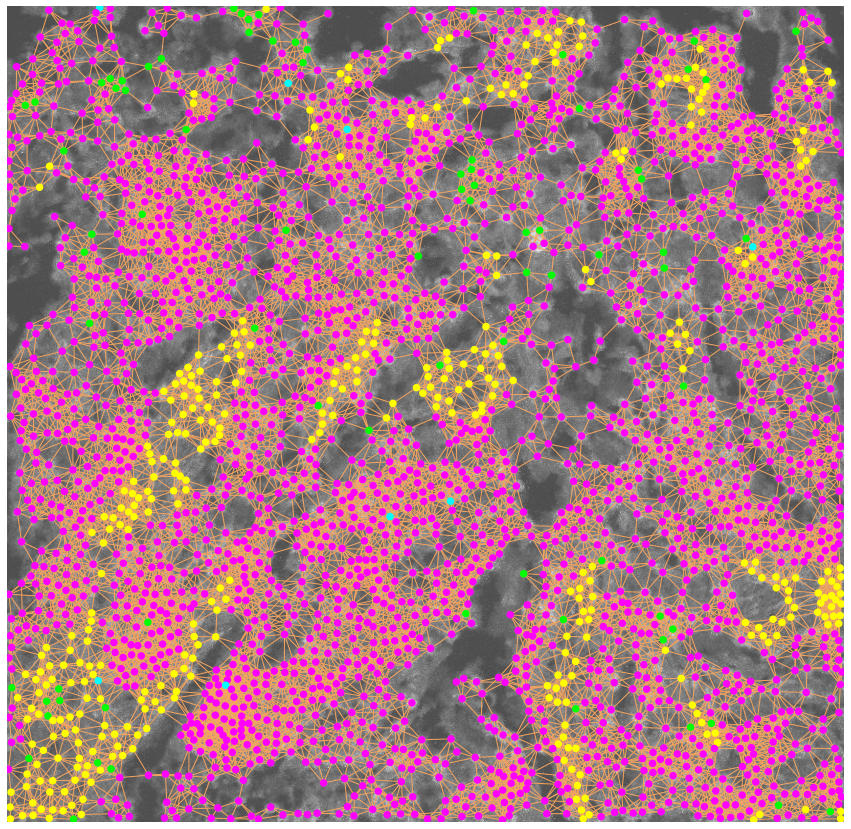

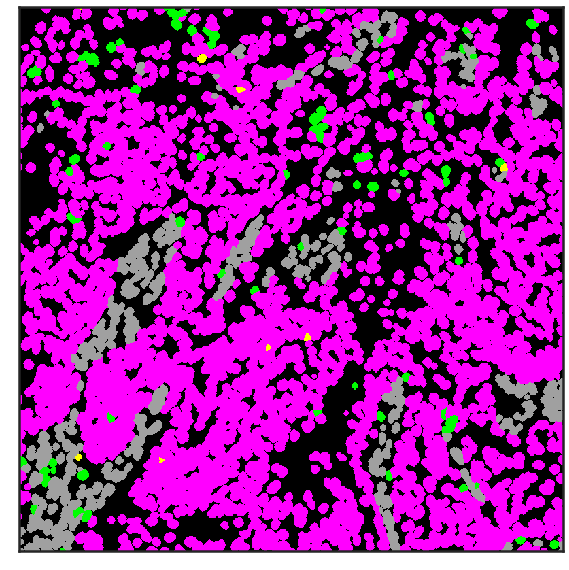

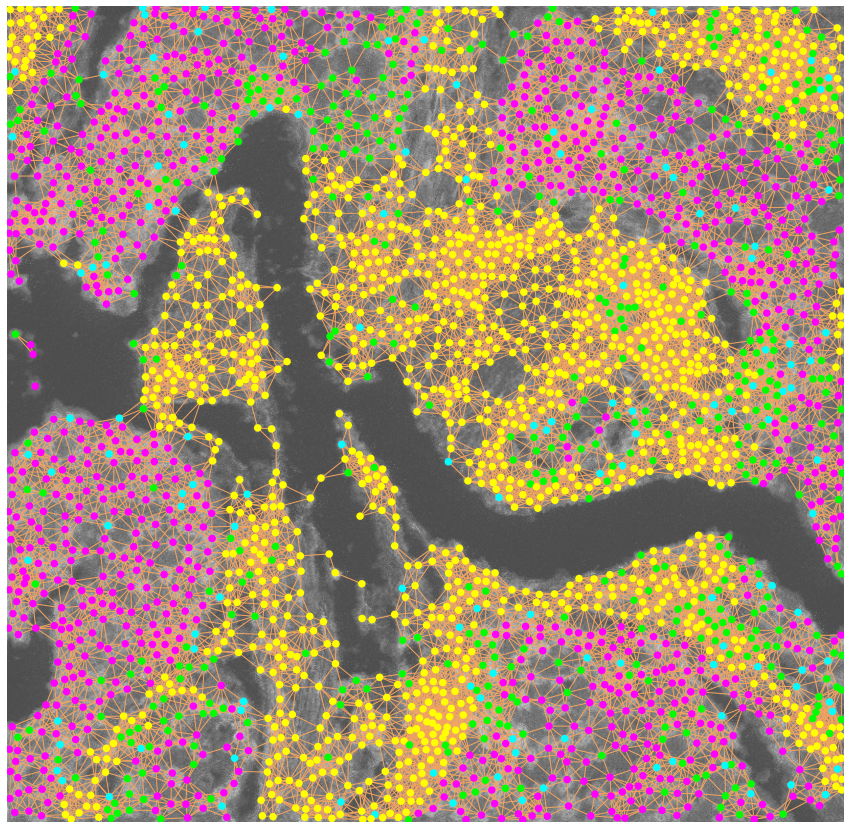

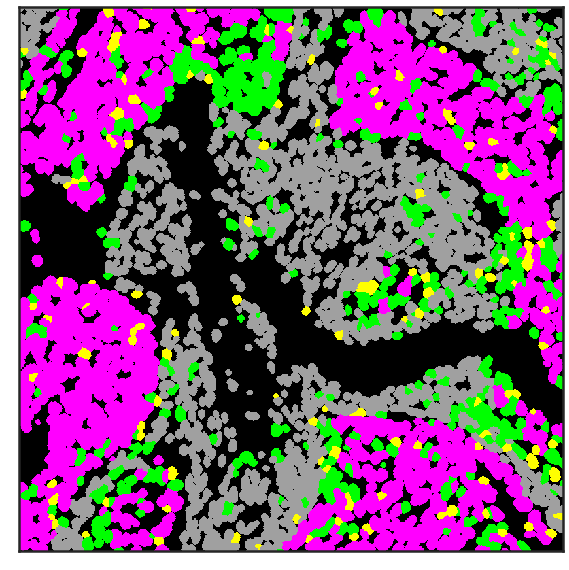

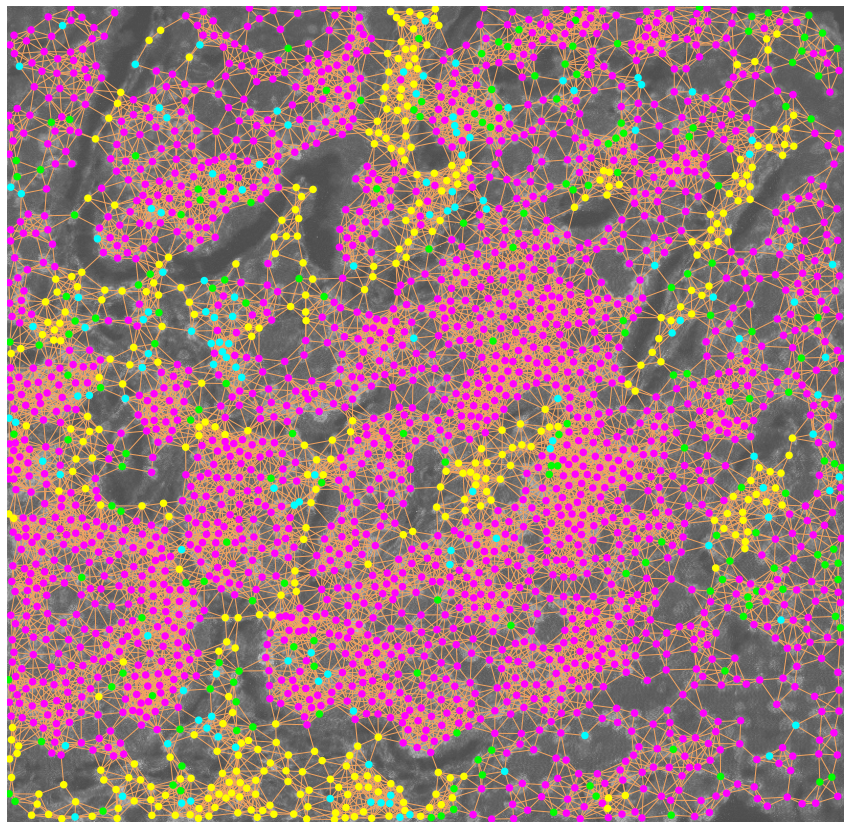

...

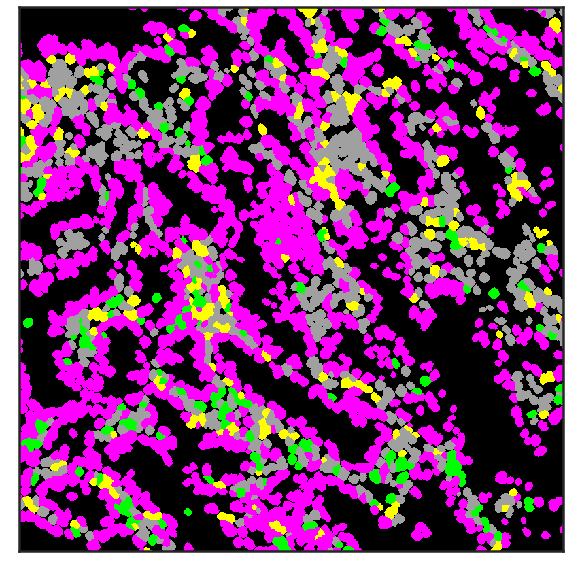

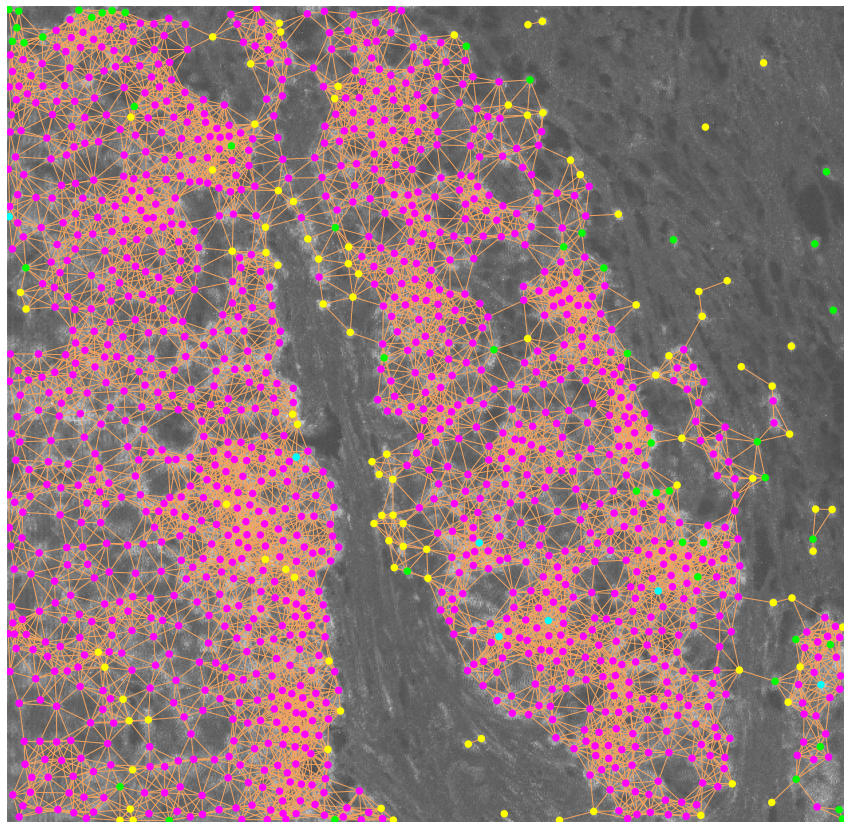

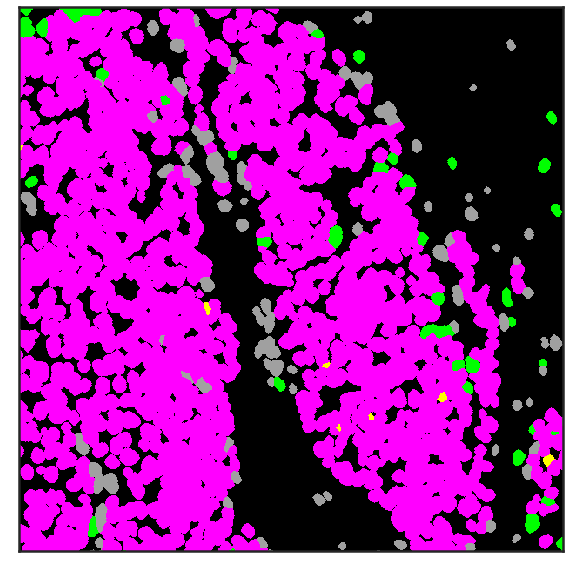

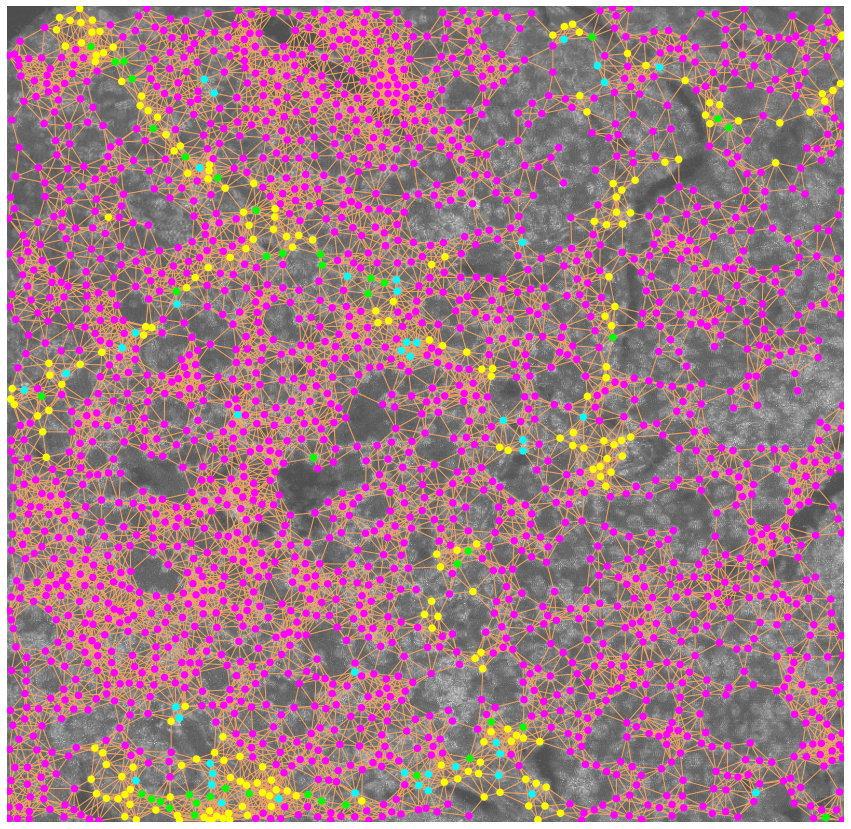

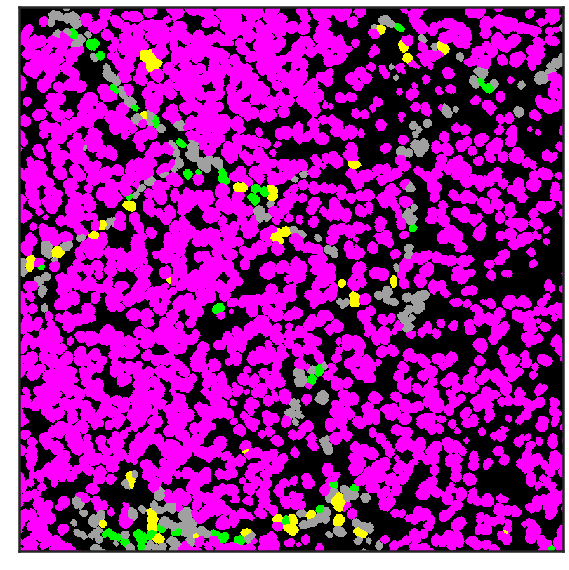

In [36]:
marker_list = [['ECadherin','PanKeratin'], ['CD68'],['CD8a'], ['Col1', 'SMA']]
labels = ['ECA+PanK', 'CD68', 'CD8a', 'Col1+SMA']
rgb = np.array([[255,0,255], [0,255,0], [0,255,255], [255,255,0], [160,160,160]])
mycmap = ListedColormap(rgb/255)
scores = defaultdict(list)
scores_count = defaultdict(list)
show=False
n = 25

for dataset in datasets:

    # Read image and cell_mask
    imgs, markers = io.read_img(dataset, data_ROI)
    marker2img = dict(zip(markers, imgs))
    cell_mask = read_cell_mask(dataset)
    min_shape = min(cell_mask.shape[0], cell_mask.shape[1])
    min_shape = myround(min_shape, base=n)
    cell_mask = cell_mask[:min_shape, :min_shape]
    
    imgs_list = []
#     p2, p98 = np.percentile(imgs, (20.0, 99.0))
    for markers in marker_list:
        temp = []
        for marker in markers:
            img = marker2img[marker]
            if marker == 'CD8a':
                img = median(img, disk(1))
            p2, p98 = np.percentile(img, (0, 99.9))
            img = exposure.rescale_intensity(img, in_range=(p2, p98))
            temp.append(img[:min_shape, :min_shape])
        imgs_list.append(np.array(np.mean(temp, axis=(0))))

    # Grayscale backgroun image
    avg_img = np.array(np.mean(imgs, axis=(0)))[:min_shape, :min_shape]

    # Get cell neighbors analysis
    distances, neighbors, cell_labels, graph, X = get_distances(cell_mask)
    df = get_cell_expression_level_mean(imgs_list, labels, cell_mask)
    df['ECA+PanK'] = df['ECA+PanK'] * 0.6
    node_class, node_colors = get_cell_color(df, labels, rgb)
    
    node_class, _ = get_cell_color(df, labels, rgb)
    neighbor_class = get_nei_info(cell_labels, neighbors, node_class, distances)
    node_patch = get_node_patch(X, node_class, n)
    
    #Plot proximity map
    fig, ax = plt.subplots(figsize=(15,15))
    ax.axis('off')
    top, right = avg_img.shape
    ax.imshow(avg_img, cmap='gray', alpha=0.7, aspect='auto', extent=[0,right,0,top], origin='lower')
    plot_nn(X, graph, node_colors, ax)
    ax.invert_yaxis()
    fig.savefig(data_figure / 'border' / f'cell_graph_{dataset}.png', bbox_inches='tight')
    
    #Plot cell mask
    img = replace_with_dict(cell_mask , node_class)
    fig, ax = plt.subplots(figsize=(10,10))
    ax.imshow(img, cmap=mycmap, interpolation='None')
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    ax.set_facecolor('black')
    fig.savefig(data_figure / 'border' / f'cell_mask_{dataset}.png', bbox_inches='tight')
    
    
    # Get Tumor and Stroma island 
    
    tumor = patch_count(0, node_class, node_patch, n, avg_img.shape)
    inegatif = patch_count(1, node_class, node_patch, n, avg_img.shape)
    ipositif = patch_count(2, node_class, node_patch, n, avg_img.shape)
    stroma = patch_count(3, node_class, node_patch, n, avg_img.shape)
    
    total = [patch_count(i, node_class, node_patch, n, avg_img.shape)  for i in range(5)]
    total = np.sum(total, axis=(0))
    P_tumor = np.divide(tumor, total, out=np.zeros_like(total), where=total!=0)
    P_ip = np.divide(ipositif, total, out=np.zeros_like(total), where=total!=0)
    P_in = np.divide(inegatif, total, out=np.zeros_like(total), where=total!=0)
    P_stroma = np.divide(stroma, total, out=np.zeros_like(total), where=total!=0)

    # IP to tumor
    ip_t_int = patch_count_neighbor(2, 0, neighbor_class, node_class, node_patch, n, avg_img.shape)
    ip_s_int = patch_count_neighbor(2, 3, neighbor_class, node_class, node_patch, n, avg_img.shape)
    ip_ip_int = patch_count_neighbor(2, 2, neighbor_class, node_class, node_patch, n, avg_img.shape)
    ip_int_total = [patch_count_neighbor(2, i, neighbor_class, node_class, node_patch, n, avg_img.shape) for i in range(5)]
    ip_int_total = np.sum(ip_int_total, axis=(0))
    P_ip_t = np.divide(ip_t_int, ip_int_total, out=np.zeros_like(ip_int_total), where=ip_int_total!=0)
    P_ip_s = np.divide(ip_s_int, ip_int_total, out=np.zeros_like(ip_int_total), where=ip_int_total!=0)
    P_ip_ip = np.divide(ip_ip_int, ip_int_total, out=np.zeros_like(ip_int_total), where=ip_int_total!=0)

    # IN to tumor
    in_t_int = patch_count_neighbor(1, 0, neighbor_class, node_class, node_patch, n, avg_img.shape)
    in_ip_int = patch_count_neighbor(1, 1, neighbor_class, node_class, node_patch, n, avg_img.shape)
    in_s_int = patch_count_neighbor(1, 3, neighbor_class, node_class, node_patch, n, avg_img.shape)
    in_int_total = [patch_count_neighbor(1, i, neighbor_class, node_class, node_patch, n, avg_img.shape) for i in range(5)]
    in_int_total = np.sum(in_int_total, axis=(0))
    P_in_t = np.divide(in_t_int, in_int_total, out=np.zeros_like(in_int_total), where=in_int_total!=0)
    P_in_s = np.divide(in_s_int, in_int_total, out=np.zeros_like(in_int_total), where=in_int_total!=0)
    P_in_in = np.divide(in_ip_int, in_int_total, out=np.zeros_like(in_int_total), where=in_int_total!=0)

    scores['Tumor'].append(round(np.mean(P_tumor),4))
    scores['Stroma'].append(round(np.mean(P_stroma),4))
    scores['IP'].append(round(np.mean(P_ip),4))
    scores['IN'].append(round(np.mean(P_in),4))
    scores['IP_T'].append(round(np.mean(P_ip_t),4))
    scores['IP_IP'].append(round(np.mean(P_ip_ip),4))
    scores['IP_S'].append(round(np.mean(P_ip_s),4))
    scores['IN_T'].append(round(np.mean(P_in_t),4))
    scores['IN_IN'].append(round(np.mean(P_in_in),4))
    scores['IN_S'].append(round(np.mean(P_in_s),4))


    scores_count['Tumor_Tumor'].append(count_neighbor(0, 0, neighbor_class, node_class))
    scores_count['Tumor_IN'].append(count_neighbor(0, 1, neighbor_class, node_class))
    scores_count['Tumor_IP'].append(count_neighbor(0, 2, neighbor_class, node_class))
    scores_count['Tumor_Stroma'].append(count_neighbor(0, 3, neighbor_class, node_class))
    scores_count['IN-IN'].append(count_neighbor(1, 1, neighbor_class, node_class))
    scores_count['IN-IP'].append(count_neighbor(1, 2, neighbor_class, node_class))
    scores_count['IN-Stroma'].append(count_neighbor(1, 3, neighbor_class, node_class))
    scores_count['IP-IP'].append(count_neighbor(2, 2, neighbor_class, node_class))
    scores_count['IP-Stroma'].append(count_neighbor(2, 3, neighbor_class, node_class))
    scores_count['Stroma-Stroma'].append(count_neighbor(3, 3, neighbor_class, node_class))
    
#     scores['Tumor'].append(P_tumor)
#     scores['Stroma'].append(P_stroma)
#     scores['IP'].append(P_ip)
#     scores['IN'].append(P_in)
#     scores['IP_T'].append(P_ip_t)
#     scores['IP_IP'].append(P_ip_ip)
#     scores['IP_S'].append(P_ip_s)
#     scores['IN_T'].append(P_in_t)
#     scores['IN_IN'].append(P_in_in)
#     scores['IN_S'].append(P_in_s)
    

## Proportion

In [37]:
df = pd.DataFrame(scores, index=datasets)
df.index = [index[-2:] for index in df.index]
df

,Tumor,Stroma,IP,IN,IP_T,IP_IP,IP_S,IN_T,IN_IN,IN_S
B1,0.7808,0.1222,0.0022,0.0274,0.0068,0.0000,0.0008,0.0393,0.0078,0.0132
B3,0.3335,0.3743,0.0404,0.1433,0.0512,0.0061,0.0331,0.0877,0.0759,0.1076
B5,0.6776,0.1491,0.0464,0.0702,0.0590,0.0107,0.0275,0.0957,0.0200,0.0300
C6,0.2510,0.1695,0.1392,0.3807,0.0987,0.0860,0.0695,0.1551,0.3196,0.0810
D7,0.2997,0.2393,0.1056,0.3545,0.0872,0.0485,0.0990,0.1100,0.2936,0.1439
D9,0.4331,0.2247,0.0468,0.0767,0.0406,0.0095,0.0256,0.0494,0.0429,0.0267
E1,0.2044,0.2297,0.3787,0.1706,0.1289,0.3178,0.1464,0.0723,0.0975,0.0972
B6,0.2703,0.2873,0.0377,0.1175,0.0268,0.0073,0.0272,0.0683,0.0531,0.0462
F3,0.2170,0.1978,0.3786,0.1979,0.0990,0.3314,0.1726,0.0462,0.1430,0.1306
F2,0.2098,0.1641,0.1357,0.3596,0.0621,0.0696,0.0653,0.1004,0.2732,0.0732


In [38]:
df_subset = df[['IP_T', 'IN_T']]
df_subset.sort_values('IP_T', inplace=True)
order = df_subset.index.tolist()

df_subset = df_subset.melt(var_name='Type', value_name='Score', ignore_index=False)
df_subset.index = df_subset.index.set_names(['ROI'])
df_subset.reset_index(inplace=True)

<ipython-input-38-0e46e86d74d9>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_subset.sort_values('IP_T', inplace=True)


# Marker per cell intensity

In [39]:
def get_cell_expression_level(marker2img_dict, mask, p2, p98):
    # Get each cell region 
    morph_prop = pd.DataFrame(measure.regionprops_table(mask, properties=['label', 'area'])).set_index('label')
    
    # Multiple each cell region by mean intensity 
    df_list = []
    for marker, img in marker2img_dict.items():
#         p2, p98 = np.percentile(img, (15.0, 100.0))
        img = exposure.rescale_intensity(img, in_range=(p2, p98))
        exp_prop = pd.DataFrame(measure.regionprops_table(mask, img, properties=['label','mean_intensity'])).set_index('label')
        df = pd.DataFrame(exp_prop.values, index=morph_prop.index, columns=[marker])
        df_list.append(df)
        
    df_exp = pd.concat(df_list, axis=1)
    return df_exp 

In [40]:
df_appended = []
for dataset in datasets:
    print(f'Working on {dataset}')
    # Read imgs, markers and cell mask info
    imgs, markers = io.read_img(dataset, data_ROI)
    marker2img = dict(zip(markers, imgs))
    mask = io.read_cell_mask(dataset, data_ROI)
    p2, p98 = np.percentile(imgs, (20.0, 99.0))
    # Show expression level
    df_exp = get_cell_expression_level(marker2img, mask, p2, p98)
    df_exp['ROI'] = dataset[-2:]
    df_appended.append(df_exp)

Working on ROI001_B1
Working on ROI005_B3
Working on ROI006_B5
Working on ROI007_C6
Working on ROI008_D7
Working on ROI009_D9
Working on ROI012_E1
Working on ROI015_B6
Working on ROI016_F3
Working on ROI017_F2
Working on ROI018_G1
Working on ROI019_G5
Working on ROI020_E5
Working on ROI021_E7


In [41]:
df_all = pd.concat(df_appended)
df_all

,SMA,Vimentin,PanKeratin,H3K9me3,PDL1,CD44,FoxP3,CD4,ECadherin,CD68,...,GranzymeB,Ki67,Col1,CD3,Histone3,CD45RO,MHCII,DNA1,DNA2,ROI
label,,,,,,,,,,,,,,,,,,,,,
1,12.626761,4.605634,33.788732,39.823944,15.936620,4.887324,6.246479,3.711268,66.035211,14.429577,...,5.429577,4.654930,4.352113,7.619718,119.591549,30.633803,109.323944,103.894366,132.443662,B1
2,18.132075,88.188679,16.056604,52.735849,17.773585,15.207547,10.301887,13.377358,50.018868,43.735849,...,10.830189,6.018868,4.924528,10.037736,140.207547,41.566038,176.094340,115.132075,146.962264,B1
3,31.430052,8.295337,156.450777,36.036269,23.875648,13.124352,11.000000,10.098446,88.704663,27.455959,...,8.652850,4.481865,8.227979,10.378238,118.362694,66.715026,160.046632,133.362694,157.155440,B1
4,17.708571,8.577143,96.771429,47.720000,19.834286,6.280000,7.034286,4.840000,86.354286,7.114286,...,10.588571,3.662857,4.702857,5.702857,131.417143,41.874286,127.960000,121.634286,152.954286,B1
5,31.709091,23.709091,86.763636,82.254545,47.654545,25.145455,12.745455,21.036364,91.345455,137.345455,...,13.254545,10.454545,26.418182,26.618182,196.745455,76.272727,193.672727,121.072727,157.236364,B1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3496,9.384106,1.854305,3.443709,39.920530,5.509934,1.543046,1.695364,1.503311,22.013245,7.629139,...,1.245033,1.119205,3.701987,1.145695,45.139073,11.033113,42.205298,151.860927,187.304636,E7
3497,6.589744,4.709402,6.188034,93.700855,9.435897,3.299145,2.555556,1.478632,11.111111,4.547009,...,1.726496,2.401709,2.700855,3.752137,118.572650,18.094017,31.760684,178.914530,217.273504,E7
3498,9.913793,3.862069,5.620690,67.775862,11.362069,4.224138,6.172414,1.431034,11.189655,7.120690,...,1.034483,2.413793,5.137931,6.344828,148.120690,25.775862,33.275862,180.051724,217.810345,E7


In [42]:
df_intensity = df_all.melt(id_vars='ROI', var_name='Marker', value_name='Intensity')
df_intensity['ROI'] = pd.Categorical(df_intensity['ROI'],
                                   categories=order,
                                   ordered=True)

In [43]:
scaler = MinMaxScaler()
df_intensity['Intensity'] = scaler.fit_transform(df_intensity[['Intensity']])

In [44]:
# def f(group):
#     return group/group.mean()

In [45]:
# df_intensity['Intensity'] = df_intensity.groupby('ROI')['Intensity'].apply(f)

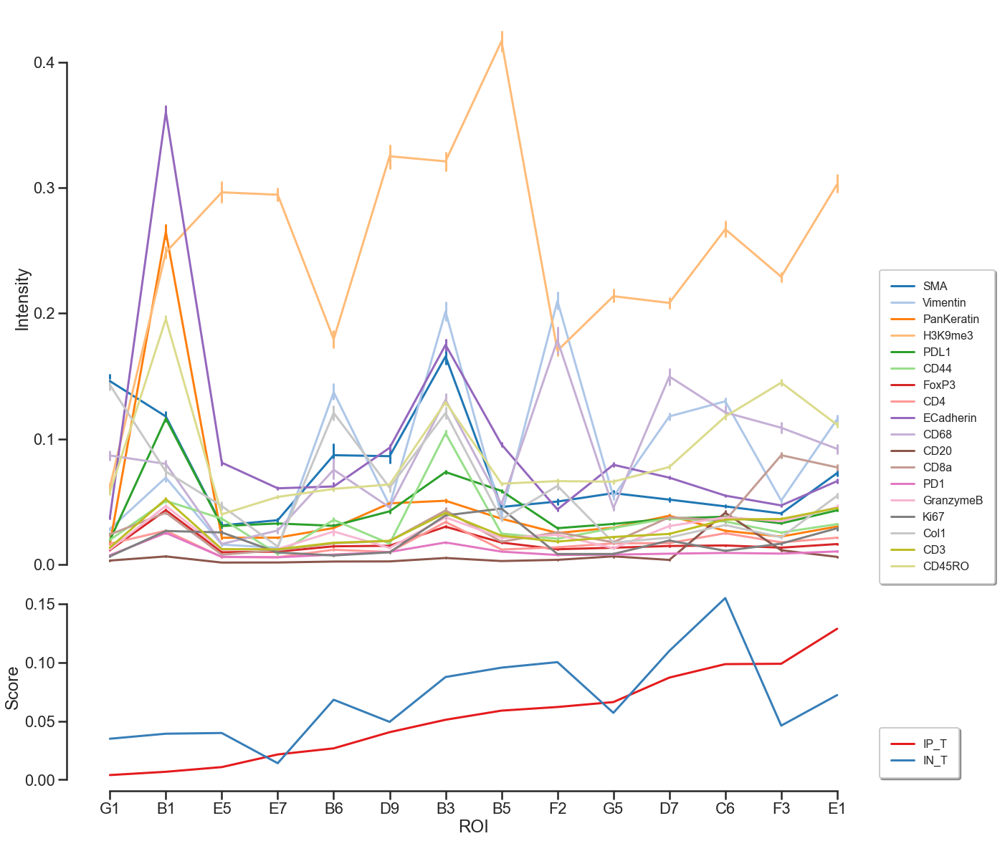

In [46]:
sns.set_style("ticks")
sns.set_context("poster")

ft = 16

fig = plt.figure(figsize=(20, 20), constrained_layout=False)
gs = fig.add_gridspec(nrows=4, ncols=1, hspace=0.0)
ax = fig.add_subplot(gs[:3,0])
ax = sns.lineplot(x="ROI", y="Intensity", hue="Marker", ci=99, 
                  err_style="bars",
                data=df_intensity[~df_intensity.Marker.isin(['DNA1', 'DNA2', 'Histone3', 'MHCII'])], palette="tab20", ax=ax)
ax.legend(
        loc="lower left",
        bbox_to_anchor=(1.0, 0.0),
        ncol=1,
        fancybox=True,
        framealpha=1,
        shadow=True,
        borderpad=1,
        fontsize=ft
    )
sns.despine(ax = ax, bottom=True)

ax = fig.add_subplot(gs[3,0])
ax = sns.lineplot(data=df_subset, x='ROI' , y='Score', hue='Type', palette="Set1", ax=ax)
ax.legend(
        loc="lower left",
        bbox_to_anchor=(1.0, 0.0),
        ncol=1,
        fancybox=True,
        framealpha=1,
        shadow=True,
        borderpad=1,
        fontsize=ft
    )

sns.despine(offset=10, trim=True, bottom=False)

In [47]:
df_intensity_sub = df_intensity[~df_intensity.Marker.isin(['DNA1', 'DNA2', 'Histone3', 'MHCII'])]
df_group = df_intensity_sub.groupby(['ROI', 'Marker']).mean().reset_index()

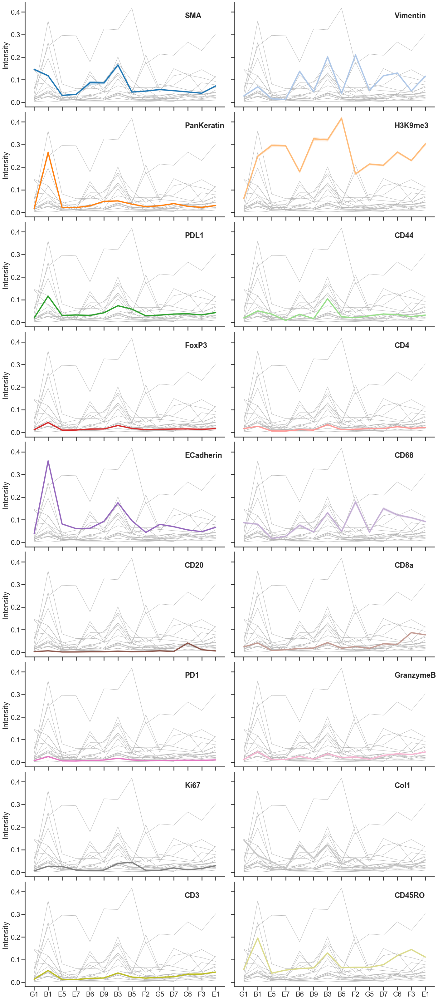

In [48]:
g = sns.relplot(
    data=df_intensity_sub,
    x="ROI", y="Intensity", hue="Marker", col="Marker",
    kind="line", palette="tab20", linewidth=4, zorder=5,
    col_wrap=2, height=5, aspect=2, legend=False)

# Iterate over each subplot to customize further
for marker, ax in g.axes_dict.items():

    # Add the title as an annotation within the plot
    ax.text(.8, .85, marker, transform=ax.transAxes, fontweight="bold")

    # Plot every marker's time series in the background
    sns.lineplot(
        data=df_group,
        x="ROI", y="Intensity", units="Marker",
        estimator=None, color=".7", linewidth=1, ax=ax,
    )

# Tweak the supporting aspects of the plot
g.set_titles("")
g.set_axis_labels("", "Intensity")
g.tight_layout()

plt.subplots_adjust(hspace=0.05, wspace=0.05)

In [49]:
df_intensity_sub = df_intensity[df_intensity.Marker.isin(['PD1', 'PDL1', 'GranzymeB', 'FoxP3', 'CD20', 'CD4'])]
df_group = df_intensity_sub.groupby(['ROI', 'Marker']).mean().reset_index()

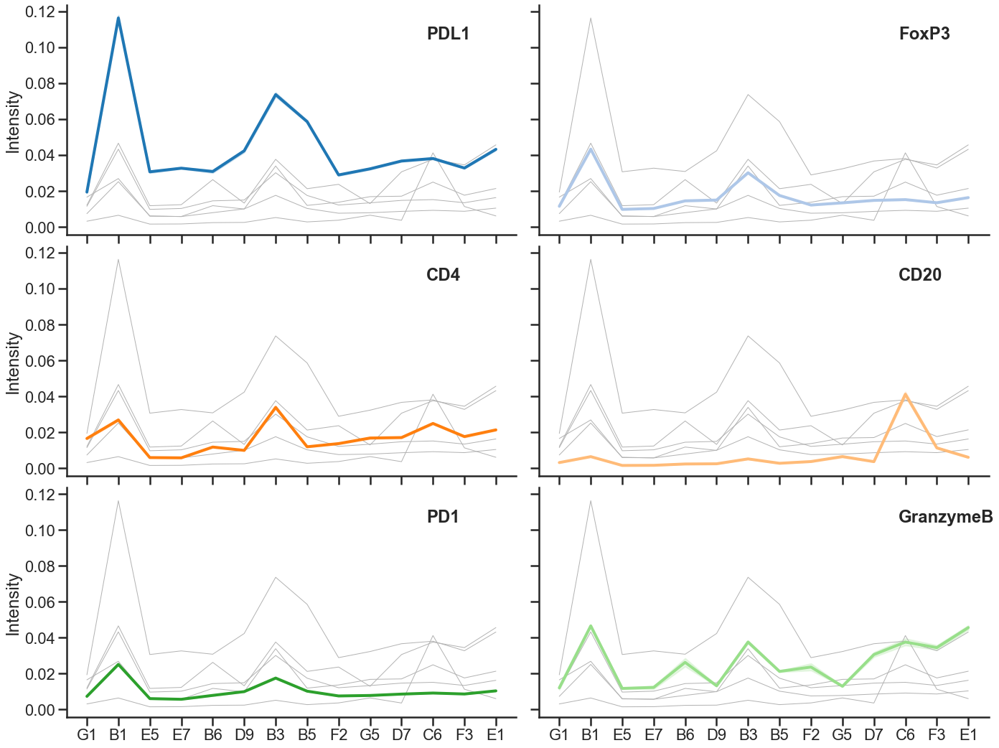

In [50]:
g = sns.relplot(
    data=df_intensity_sub,
    x="ROI", y="Intensity", hue="Marker", col="Marker",
    kind="line", palette="tab20", linewidth=4, zorder=5,
    col_wrap=2, height=5, aspect=2, legend=False)

# Iterate over each subplot to customize further
for marker, ax in g.axes_dict.items():

    # Add the title as an annotation within the plot
    ax.text(.8, .85, marker, transform=ax.transAxes, fontweight="bold")

    # Plot every marker's time series in the background
    sns.lineplot(
        data=df_group,
        x="ROI", y="Intensity", units="Marker",
        estimator=None, color=".7", linewidth=1, ax=ax,
    )

# Tweak the supporting aspects of the plot
g.set_titles("")
g.set_axis_labels("", "Intensity")
g.tight_layout()

plt.subplots_adjust(hspace=0.05, wspace=0.05)